## Homework 1 (Chapter III)

pubmed_cleaned.zip is a file containing a metadatas sample from pubmed articles. Your goal is to **convert the json to a mongo DB** and answer the following questions **USING** mongodb querys:

In [6]:
# Conversion du json en mongo DB :
import pymongo
import json

client = pymongo.MongoClient('localhost', 27017)
mydb = client["Homework_1"]
collection = mydb["Pubmed"]

with open("data/Chap3/pubmed_cleaned.json", "r") as f:
    data = json.load(f)

# Suppression de la notation $oid pour permettre l'insertion dans MongoDB
for doc in data:
    if '_id' in doc and '$oid' in doc['_id']:
        doc['_id'] = {'oid': doc['_id']['$oid']}

# Insertion des données dans la collection MongoDB
collection.insert_many(data)

1) Create an index, explain your choice of key.

In [7]:
client = pymongo.MongoClient('localhost', 27017)
mydb = client["Homework_1"]
collection = mydb["Pubmed"]

collection.create_index("pmid")

'pmid_1'

J'ai choisi la clé "pmid" puisque c'est un identifiant unique pour chaque papier. Cela pourra être utile pour faire des requêtes de recherche et de mise à jour sur des documents spécifiques en utilisant cet identifiant.

2) Delete every paper that was published prior 2019

In [9]:
client = pymongo.MongoClient('localhost', 27017)
mydb = client["Homework_1"]
collection = mydb["Pubmed"]

collection.delete_many({"date": {"$lt": "year 2019"}})

3) How many paper have a single author ? Two authors ?

In [22]:
count_one_author = 0
count_two_authors = 0

for doc in collection.find():
    authors = doc['authors'].split('\n')
    num_authors = len(authors)
    
    if num_authors == 1:
        count_one_author += 1
    elif num_authors == 2:
        count_two_authors += 1

print("Nombre de papiers avec un seul auteur :", count_one_author)
print("Nombre de papiers avec deux auteurs :", count_two_authors)

Nombre de papiers avec un seul auteur : 5480
Nombre de papiers avec deux auteurs : 10153


4) What's the last paper inserted in the db ?

In [10]:
last_paper = collection.find_one(sort=[('_id', pymongo.DESCENDING)])
print({"_id": last_paper["_id"]["oid"]})

{'_id': '60c753bac4b7559e040fe2b3'}


5) Find articles with null meshwords.

In [7]:
from pprint import pprint

empty_meshwords = collection.find({"meshwords": ""})
for doc in empty_meshwords:
    pprint(doc["title"])

'A smartphone comes to the rescue during tracheostomy.'
('Analysis of a Sardinian Multiplex Family with Autism Spectrum Disorder '
 'Points to Post-Synaptic Density Gene Variants and Identifies CAPG as a '
 'Functionally Relevant Candidate Gene.')
('Fifteen new species of Chilicola (Oroediscelis) (Hymenoptera: Colletidae: '
 'Xeromelissinae) with illustrated keys to the males and females of the '
 'subgenus.')
('Stress-responsive miRNAome of Glycine max (L.) Merrill: molecular insights '
 'and way forward.')
('Prolapse mesh complication: large stone on vaginal mesh extruded in the '
 'bladder.')
'Nonlinear Vibration of a Micro Piezoelectric Precision Drive System.'
'Robust Mesh Denoising via Triple Sparsity.'
('Intraventricular Meningioma Presenting as Lateral Posterior Choroidal Artery '
 'Stroke.')
('Costal chondrosarcoma mimicking a breast cancer: Case report and review of '
 'literature.')
('3D Metallic Ti@Ni0.85 Se with Triple Hierarchy as High-Efficiency '
 'Electrocatalyst for O

6) Choose a keyword you are interested in (machine learning, computer vision,...). Find the number of articles with the choosen keyword in their meshwords, abstract or title.

In [53]:
count = collection.count_documents({"$or": [
    {"meshwords": {"$regex": ".*data science.*"}},
    {"abstract": {"$regex": ".*data science.*"}},
    {"title": {"$regex": ".*data science.*"}}
]})
print("Nombre d'articles avec le mot clé 'data science':", count)

Nombre d'articles avec le mot clé 'data science': 12


7) What's the number of articles that have atleast one affiliation AND meshwords.

In [55]:
count = collection.count_documents({"$and": [{"authors": {"$regex": ".*affil.*"}}, {"meshwords": {"$exists": 1}}]})
print("Nombre d'articles avec au moins une affiliation et meshword :", count)

Nombre d'articles avec au moins une affiliation et meshword : 99413


8) How many articles have a publishing date after 2020 ?

In [2]:
count = collection.count_documents({"date": {"$gte": "year 2020"}})
print("Nombre d'articles avec une date de publication après 2020 :", count)

Nombre d'articles avec une date de publication après 2020 : 0


9) Find articles where there's atleast one affiliation from a choosen country (you decide which one).

In [5]:
from pprint import pprint

resultats = collection.find({"authors": {"$regex": "China"}})

for resultat in resultats:
    pprint({"_id": resultat["_id"]["oid"], "authors": resultat["authors"]})

{'_id': '60c73416c4b7559e0406bc7e',
 'authors': 'name ml Liu CM, affil str Institute of Crop Sciences, Chinese '
            'Academy of Agricultural Sciences, Beijing, China.\n'
            'name ml Lucas WB, affil str Distinguished Research Professor, '
            'Department of Plant Biology, University of California, Davis, CA, '
            'USA.'}
{'_id': '60c73465c4b7559e0406d3de',
 'authors': 'name ml Liu Z, affil str Department of Plastic Surgery, Zhongnan '
            'Hospital of Wuhan University, Wuhan, China.\n'
            'name ml Hu D, affil str Department of Plastic Surgery, Zhongnan '
            'Hospital of Wuhan University, Wuhan, China.\n'
            'name ml Huang Y, affil str Department of Plastic Surgery, '
            'Zhongnan Hospital of Wuhan University, Wuhan, China.\n'
            'name ml Chen S, affil str Department of Plastic Surgery, Zhongnan '
            'Hospital of Wuhan University, Wuhan, China.\n'
            'name ml Zeng W, affil str Depart

10) Check for any duplicates. (hint: look at the doi or the pmid)

In [15]:
resultats = collection.aggregate([
    {"$group": {"_id": "$doi", "count": {"$sum": 1}}},
    {"$match": {"count": {"$gt": 1}}}
])

for resultat in resultats:
    print(resultat)

{'_id': '10.23876/j.krcp.19.006', 'count': 2}
{'_id': ' } } }, from journal { title { iso-jta ', 'count': 10}
{'_id': '10.1093/jnci/djz062', 'count': 2}
{'_id': ', affil str ', 'count': 40}
{'_id': ' }, { name ml ', 'count': 55}
{'_id': '10.1093/cid/ciz518', 'count': 2}
{'_id': '10.1093/jas/skz192', 'count': 2}
{'_id': ' }, authors { names std { { name ml ', 'count': 73}
{'_id': '', 'count': 5}


Note : Certains résultats ne semblent pas correspondre à un doi : il est possible que ces résultats soient dus à une erreur de formatage des données dans la collection.

11) Remove every articles where the abstract starts with an "R".

In [16]:
collection.delete_many({"abstract": {"$regex": "^R" }})

12) Return the list of papers (pmid) where there's atleast one affiliation per author

In [17]:
pmids = []

# Recherche de tous les documents avec un champ "authors"
for doc in collection.find({"authors": {"$exists": True}}):
    affiliations = []
    authors = doc['authors'].split('\n') 
    
    # Vérification si chaque auteur a au moins une affiliation
    for author in authors:
        if 'affil' in author:
            affiliations.append(author)
    
    # Si chaque auteur a au moins une affiliation, on ajoute le pmid à la liste
    if len(affiliations) == len(authors):
        pmids.append(doc['pmid'])

print(pmids)

[30608900, 30614081, 30614166, 30614610, 30614629, 30615595, 30615597, 30615818, 30615980, 30618194, 30620089, 30620121, 30620713, 30621200, 30622149, 30624690, 30624702, 30624841, 30625514, 30626152, 30626732, 30627924, 30629332, 30629810, 30629812, 30630063, 30630289, 30631788, 30631944, 30633307, 30635026, 30636019, 30636978, 30637770, 30637785, 30637966, 30638935, 30639135, 30639237, 30639419, 30639457, 30639549, 30639777, 30639781, 30640037, 30641129, 30641131, 30641134, 30641145, 30641149, 30641246, 30641387, 30641886, 30641906, 30642096, 30642391, 30642749, 30642780, 30642903, 30644080, 30644106, 30644172, 30644615, 30645024, 30645031, 30645189, 30645190, 30645676, 30645685, 30646603, 30646842, 30646862, 30647244, 30647248, 30647249, 30647258, 30647259, 30647263, 30647265, 30647266, 30647290, 30647296, 30647307, 30647311, 30647316, 30647320, 30648532, 30648544, 30648967, 30649267, 30649312, 30649525, 30650221, 30650235, 30651124, 30651143, 30651214, 30651217, 30651220, 30651221,

13) Create 500 random samples of the dataset, compute a statistics that you are interested in and check how it behaves through the different samples

In [15]:
import pymongo
import random

client = pymongo.MongoClient('localhost', 27017)
mydb = client["Homework_1"]
collection = mydb["Pubmed"]

num_samples = 500
sample_size = 10
meshwords_means = []

for i in range(num_samples):
    # Récupère les documents avec au moins un meshword non vide et fait un échantillon aléatoire de la taille sample_size
    sample_docs = list(collection.aggregate([
        {'$match': {'meshwords': {'$ne': None, '$ne': ''}}},
        {'$sample': {'size': sample_size}}
    ]))
    
    # Crée une collection temporaire pour stocker l'échantillon
    temp_collection = mydb[f"sample_{i}"]
    
    temp_collection.insert_many(sample_docs)
    meshwords_mean = sum([len(doc['meshwords'].split('\n')) for doc in sample_docs if doc.get('meshwords')]) / sample_size
    meshwords_means.append(meshwords_mean)
    
    # Supprime la collection temporaire
    mydb.drop_collection(temp_collection.name)


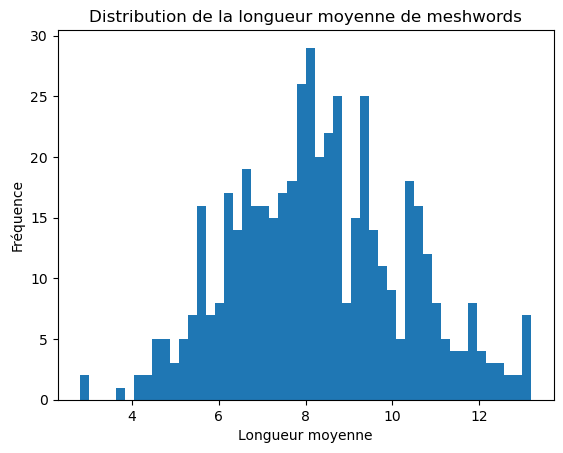

In [16]:
import matplotlib.pyplot as plt

plt.hist(meshwords_means, bins=50)
plt.title("Distribution de la longueur moyenne de meshwords")
plt.xlabel("Longueur moyenne")
plt.ylabel("Fréquence")
plt.show()

14) Sandbox exercise: think of a problematic and try to answer it.

In [17]:
# Calculer la moyenne du nombre de pays par articles
resultats = collection.aggregate([{"$group": {"_id": None, "moyenne": {"$avg": "$nb_country"}}}])
for resultat in resultats:
    print("La moyenne du nombre de pays par article est de : ", resultat["moyenne"])

La moyenne du nombre de pays par article est de :  1.2826641332066604


## Homework 5 : cet exercice a été réalisé en duo avec Jason MOREL

You will work on a Twitch dataset found [here](https://www.kaggle.com/andreagarritano/twitch-social-networks). The goal is to learn more about the feat&fun on Twitch. First thing to do is create the network on Neo4j. Insert the node
from Twitch/FR_target and then the edges from Twitch/FR_edges.csv in neo4j. Answer the following using cypher queries

In [58]:
from py2neo import Graph, Node, Relationship
graph = Graph("bolt://localhost:7687", auth=("neo4j", "homework"), name="twitch")

# Création des noeuds
with open("data/Chap4/Homework_data/Twitch/FR_target.csv") as f:
    next(f)
    for line in f:
        id, days, mature, views, partner, new_id = line.strip().split(",")
        node = Node("Twitch_FR",
                    id=id,
                    days=int(days),
                    mature=mature,
                    views=int(views),
                    partner=partner,
                    new_id=int(new_id))
        graph.create(node)


In [59]:
from py2neo import Graph, Node, Relationship

graph = Graph("bolt://localhost:7687", auth=("neo4j", "homework"), name="twitch")

# Création des relations
with open("data/Chap4/Homework_data/Twitch/FR_edges.csv") as f:
    next(f)
    for line in f:
        from_id, to_id = line.strip().split(",")
        from_node = graph.nodes.match("Twitch_FR", new_id=int(from_id)).first()
        to_node = graph.nodes.match("Twitch_FR", new_id=int(to_id)).first()
        if from_node and to_node:
            relationship = Relationship(from_node, "FOLLOWS", to_node)
            graph.create(relationship)


1) Give the IDs of the top 10 streamers that have atleast one collaboration.

In [60]:
query = """
MATCH (streamer:Twitch_FR)-[r:FOLLOWS]->()
WITH streamer, COUNT(DISTINCT r) AS num_collab
WHERE num_collab > 0
RETURN streamer.id
ORDER BY streamer.views DESC
LIMIT 10
"""

result = graph.run(query)
for record in result:
    print(record["streamer.id"])

71852533
84934385
24147592
41719107
174955366
147337432
40063341
142506321
29478753
27528066


2) Create a density of node degrees. Do you observe a power scale law ? What does it mean ?

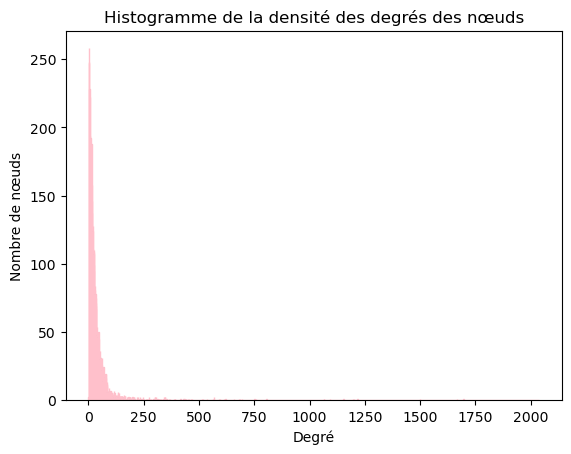

In [115]:
import matplotlib.pyplot as plt
from py2neo import Graph

# Requête Cypher pour récupérer les degrés des nœuds
query = """
MATCH (n)
OPTIONAL MATCH (n)-[r]-()
WITH n, COUNT(r) AS degree
RETURN degree
"""
result = graph.run(query)

# Collecter les degrés dans une liste
degrees = [record["degree"] for record in result]

# Créer un histogramme
plt.hist(degrees, bins=range(min(degrees), max(degrees)), edgecolor='pink')
plt.xlabel('Degré')
plt.ylabel('Nombre de nœuds')
plt.title('Histogramme de la densité des degrés des nœuds')
plt.show()


Il y a une forte concentration des degrés à 0 ou a des valeurs très faibles, cela signifie que beaucoup de streamers ne collaborent avec personne ou avec très peu d'autres streamers.

3) How many streamers has the tag "mature" ?

In [62]:
query = """
MATCH (n:Twitch_FR)
WHERE n.mature = 'True'
RETURN count(n) as count
"""

result = graph.run(query).to_table()
print(f"Nombre de streamers ayant le tag 'mature': {result[0][0]}")

Nombre de streamers ayant le tag 'mature': 2416


4) Is the collaboration correlated to the "mature" tag ?

In [85]:
# Nombre moyen de collaborations pour les streamers qui ont le tag mature
query1 = """
MATCH (s:Twitch_FR)-[:FOLLOWS]->(f)
WHERE s.mature = 'True'
WITH s, COUNT(f) AS collab_count
RETURN AVG(collab_count)
"""
result1 = graph.run(query1).to_table()
print("Nombre moyen de collaborations pour les streamers qui ont le tag mature : ", result1[0][0])

# Nombre moyen de collaborations pour les streamers qui n'ont pas le tag mature
query2 = """
MATCH (s:Twitch_FR)-[:FOLLOWS]->(f)
WHERE s.mature = 'False'
WITH s, COUNT(f) AS collab_count
RETURN AVG(collab_count)
"""
result2 = graph.run(query2).to_table()
print("Nombre moyen de collaborations pour les streamers qui n'ont pas le tag mature : ", result2[0][0])


Nombre moyen de collaborations pour les streamers qui ont le tag mature :  20.279069767441868
Nombre moyen de collaborations pour les streamers qui n'ont pas le tag mature :  18.48576850094866


Il n'y a pas une énorme différence dans le nombre de collaborations pour les streamers qui ont le tag et ceux qui ne l'ont pas, mais les streamers qui ont le tag mature ont tout de même davantage de collaborations que les autres.

5) Do partners collaborate more than non partners ?

In [86]:
# Nombre moyen de collaborations pour les streamers qui ont le tag partner
query1 = """
MATCH (s:Twitch_FR)-[:FOLLOWS]->(f)
WHERE s.partner = 'True'
WITH s, COUNT(f) AS collab_count
RETURN AVG(collab_count)
"""
result1 = graph.run(query1).to_table()
print("Nombre moyen de collaborations pour les streamers qui ont le tag partner : ", result1[0][0])

# Nombre moyen de collaborations pour les streamers qui n'ont pas le tag partner
query2 = """
MATCH (s:Twitch_FR)-[:FOLLOWS]->(f)
WHERE s.partner = 'False'
WITH s, COUNT(f) AS collab_count
RETURN AVG(collab_count)
"""
result2 = graph.run(query2).to_table()
print("Nombre moyen de collaborations pour les streamers qui n'ont pas le tag partner : ", result2[0][0])


Nombre moyen de collaborations pour les streamers qui ont le tag partner :  94.22332506203477
Nombre moyen de collaborations pour les streamers qui n'ont pas le tag partner :  13.632779704325566


Ici, on remarque une nette différence : les streamers avec le tag partner collaborent nettement plus que ceux qui ne l'ont pas.

6) Sandbox exercise: think of a problematic and try to answer it.

In [107]:
# Recherche si les cinq streamers avec le moins de vues ont eu des collaborations
query = """
MATCH (n:Twitch_FR)
WHERE (n)-[:FOLLOWS]->()
RETURN n.id
ORDER BY n.views DESC
LIMIT 5
"""

result = graph.run(query)
for record in result:
    streamer_id = record["n.id"]
    collaboration_query = f"""
    MATCH (n:Twitch_FR {{id: '{streamer_id}'}})-[:FOLLOWS]->(collaborator)
    RETURN count(collaborator) AS num_collaborations
    """
    collaboration_result = graph.run(collaboration_query).evaluate()
    if collaboration_result >= 1:
        print(f"{streamer_id} a au moins une collaboration")
    else:
        print(f"{streamer_id} n'a pas de collaboration")

71852533 a au moins une collaboration
84934385 a au moins une collaboration
24147592 a au moins une collaboration
41719107 a au moins une collaboration
174955366 a au moins une collaboration
